## Blob/(Small connected component) removal

As we noticed some small blobs on the images we tried to remove them by detecting connected
components on the image. We noticed that this didn't improve out scores and thus didn't
implement this into our final pipeline. Still we left this notebook here for possible
inspiration.

In [1]:
import os

import numpy as np

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import cv2

%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
def open_image(path):
    return mpimg.imread(path)
    # return Image.open(path)

def pil_img_to_array(img):
    return np.array(img, dtype = np.float32)/255

In [3]:
TEST_PREDICTIONS_PATH = 'data/test_predictions/'

test_pred_paths = os.listdir(TEST_PREDICTIONS_PATH)
test_pred_paths.sort()
test_pred_paths

['.DS_Store',
 'prediction_001.png',
 'prediction_002.png',
 'prediction_003.png',
 'prediction_004.png',
 'prediction_005.png',
 'prediction_006.png',
 'prediction_007.png',
 'prediction_008.png',
 'prediction_009.png',
 'prediction_010.png',
 'prediction_011.png',
 'prediction_012.png',
 'prediction_013.png',
 'prediction_014.png',
 'prediction_015.png',
 'prediction_016.png',
 'prediction_017.png',
 'prediction_018.png',
 'prediction_019.png',
 'prediction_020.png',
 'prediction_021.png',
 'prediction_022.png',
 'prediction_023.png',
 'prediction_024.png',
 'prediction_025.png',
 'prediction_026.png',
 'prediction_027.png',
 'prediction_028.png',
 'prediction_029.png',
 'prediction_030.png',
 'prediction_031.png',
 'prediction_032.png',
 'prediction_033.png',
 'prediction_034.png',
 'prediction_035.png',
 'prediction_036.png',
 'prediction_037.png',
 'prediction_038.png',
 'prediction_039.png',
 'prediction_040.png',
 'prediction_041.png',
 'prediction_042.png',
 'prediction_043.png

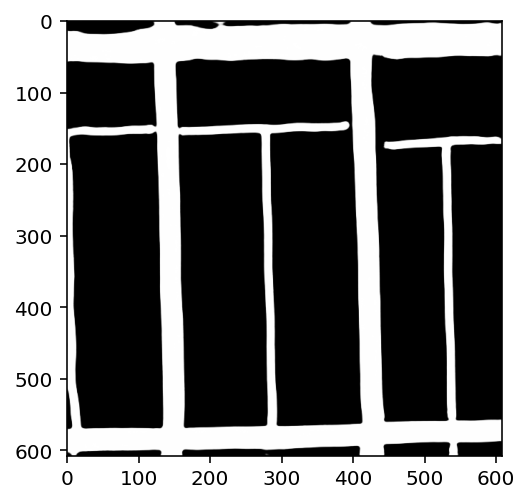

In [4]:
i=1
img = open_image(TEST_PREDICTIONS_PATH + test_pred_paths[i])
plt.imshow(img, cmap='gray')

In [5]:
def load_imgs(i):
    img_path = f'data/test_set_images/test_{i}/test_{i}.png'
    pred_path = f'data/test_predictions/prediction_{i:03}.png'

    img = open_image(img_path)
    img_pred = open_image(pred_path)

    return img, img_pred

In [6]:
def show_images(img, img_pred):
    fig, ax = plt.subplots(1,2, sharey=True, figsize=(10, 10))

    for i in range(0,2):
        ax[i].set_axis_off()

    ax[0].imshow(img);
    ax[1].imshow(img_pred, cmap='gray');

    fig.tight_layout()


In [42]:
def show_images_smart(images, cmaps):
    num_images = len(images)
    figsize = 10
    fig, ax = plt.subplots(1, num_images, figsize=(figsize, figsize))

    for i in range(0,num_images):
        # ax[i].set_axis_off()
        ax[i].imshow(images[i], cmap=cmaps[i])

    plt.tight_layout()
    plt.show()


In [28]:
def show_stuff(i, show_adj=False):
    # img_path = f'data/training/images/satImage_{i:03}.png'
    # gt_path = f'data/training/groundtruth/satImage_{i:03}.png'
    # pred_path = f'data/training/predictions/prediction_{i:03}.png'
    
    img_path = f'data/test_set_images/test_{i}/test_{i}.png'

    pred_path = f'data/test_predictions/prediction_{i:03}.png'

    if show_adj:
        pred_adj_path = f'data/adj_predictions/prediction_{i:03}.png'

    img = open_image(img_path)
    # img_gt = open_image(gt_path)
    img_pred = open_image(pred_path)

    if show_adj:
        pred_adj = open_image(pred_adj_path)

    # img_diff = np.abs(img_gt - img_pred)

    # display images
    fig, ax = plt.subplots(1,3, figsize=(10, 10))

    # for i in range(0,len(ax)):
    #     ax[i].set_axis_off()

    ax[0].imshow(img);
    ax[1].imshow(img_pred, cmap='gray');
    
    if show_adj:
        ax[2].imshow(pred_adj, cmap='gray')

    plt.show()
    # ax[2].imshow(img_diff, cmap='gray');
    # ax[3].imshow(img_gt, cmap='gray');
    
    fig.tight_layout()
    # fig.show()

1


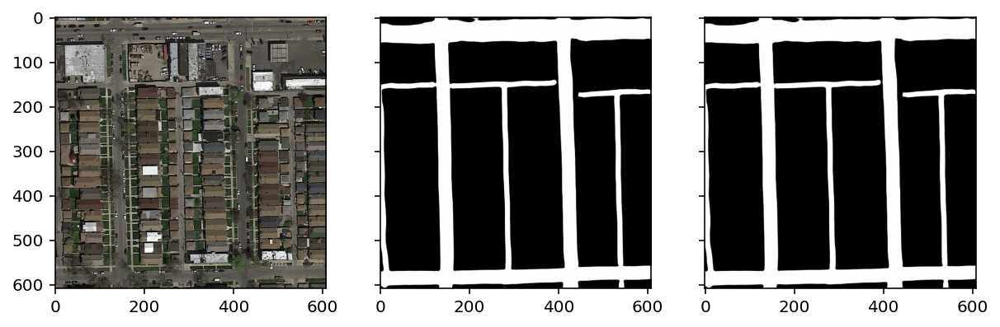

2


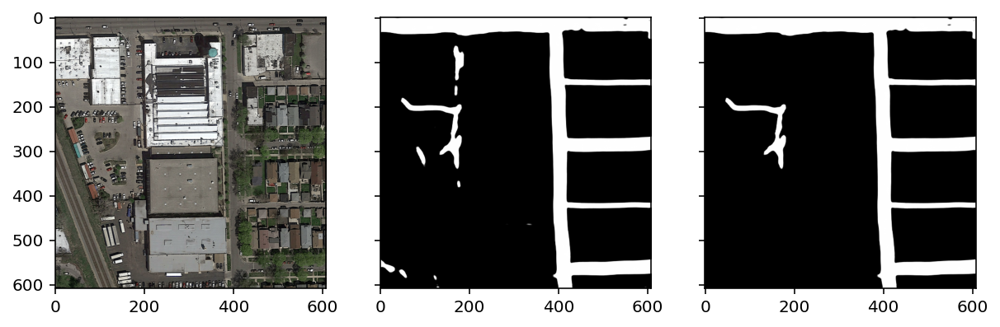

3


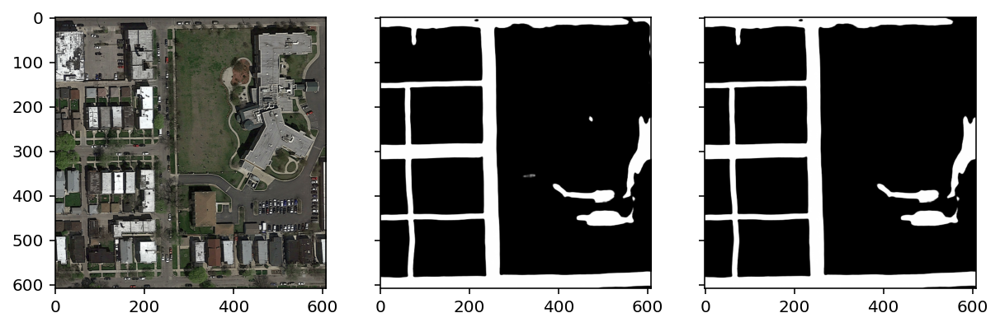

4


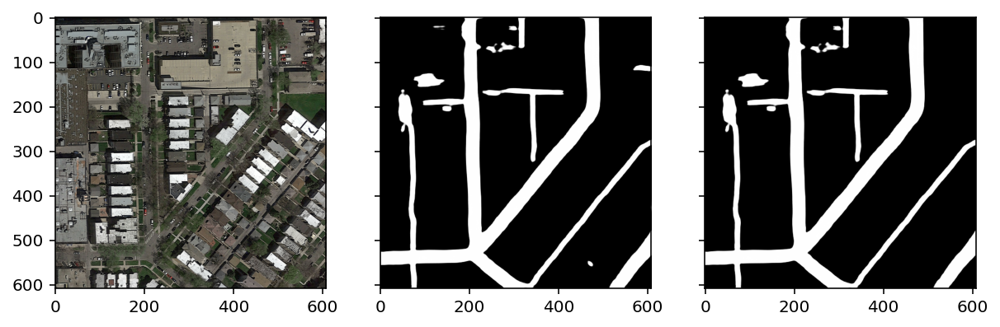

5


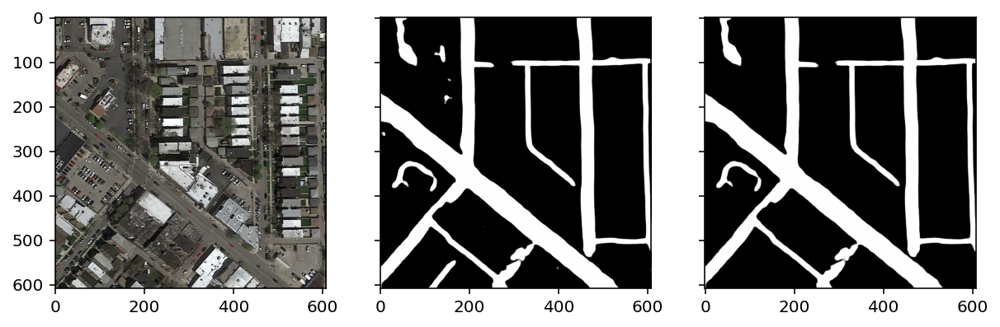

6


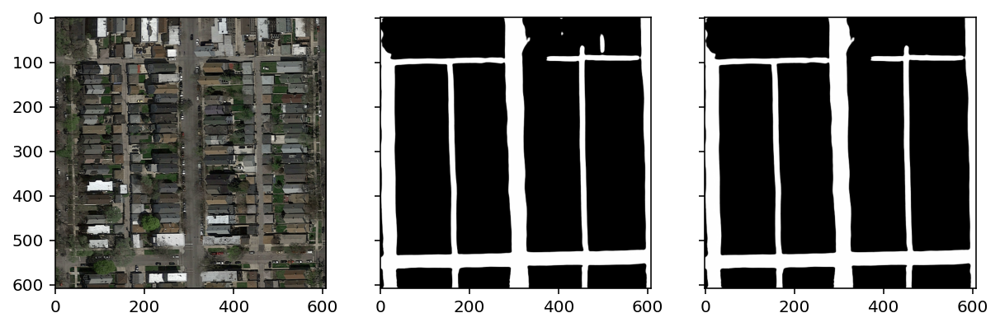

7


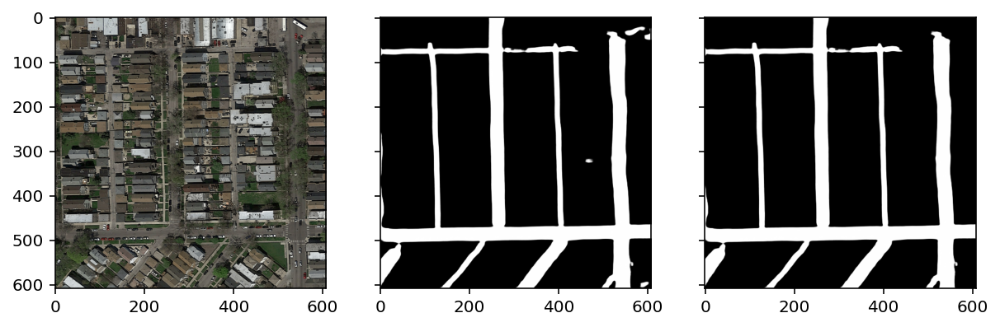

8


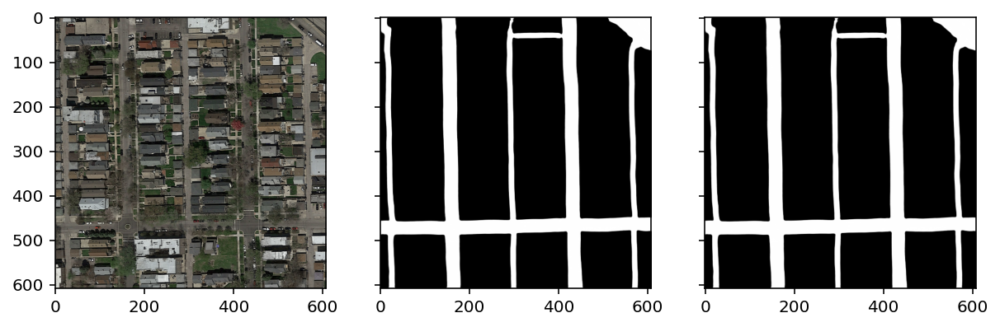

9


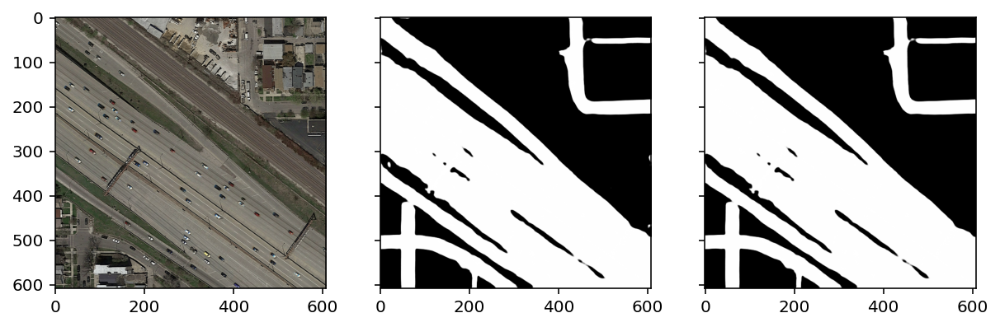

10


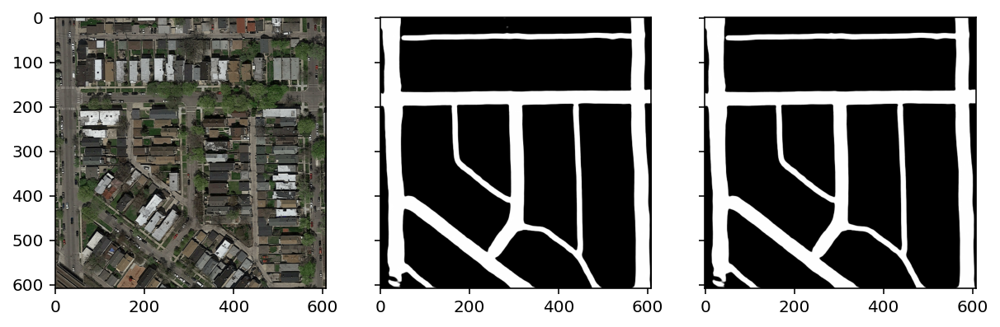

11


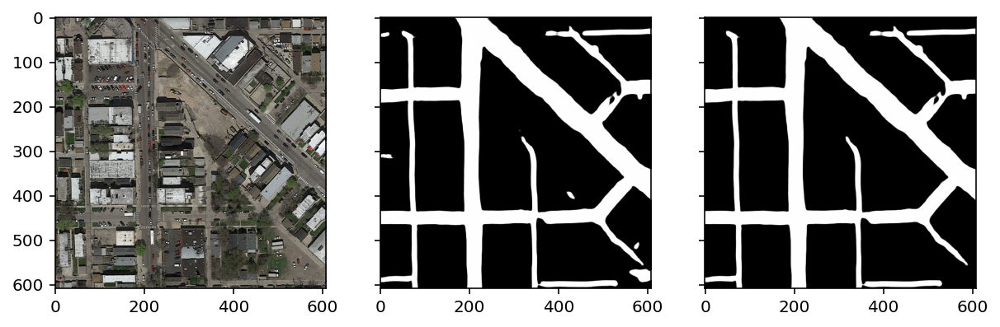

12


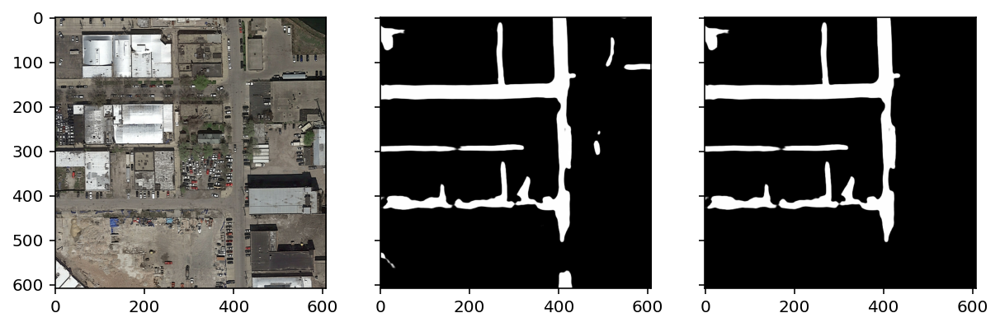

13


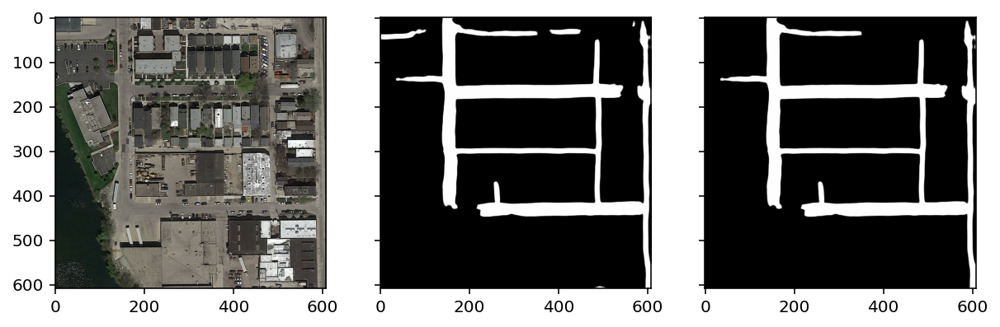

14


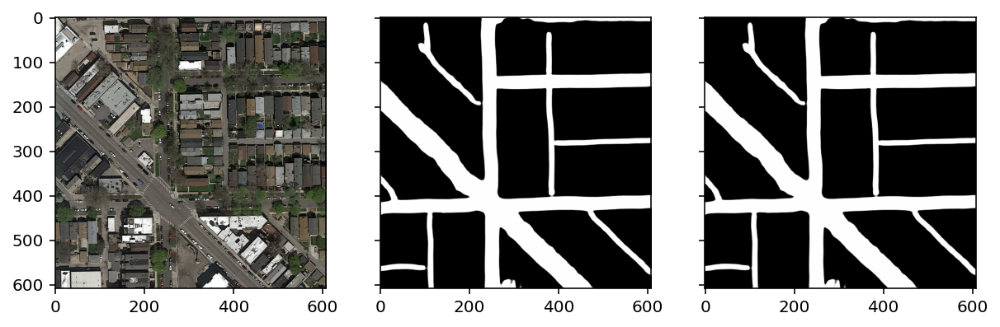

15


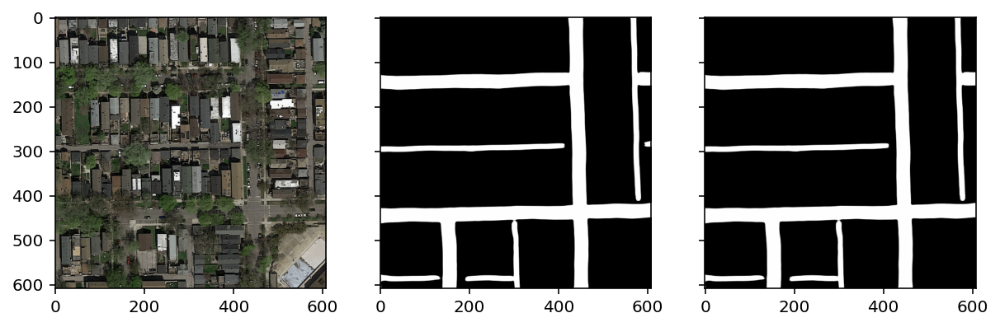

16


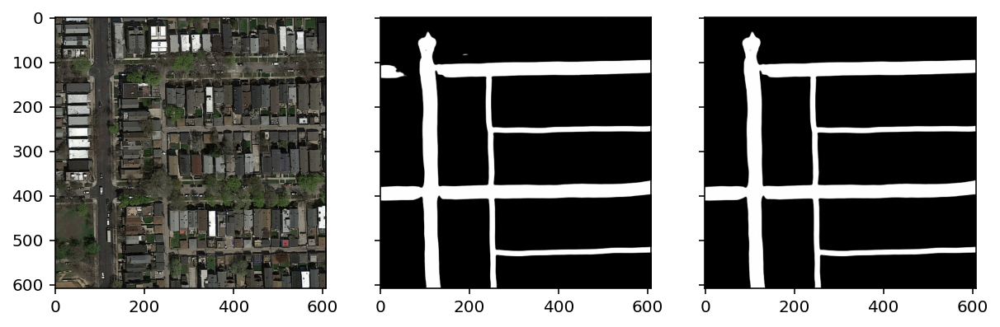

17


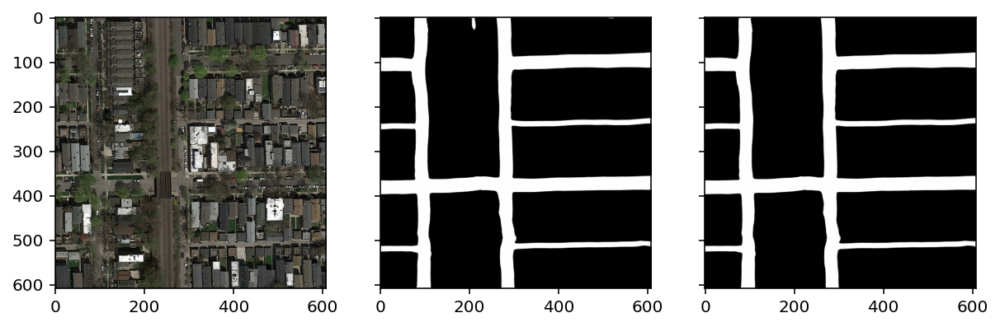

18


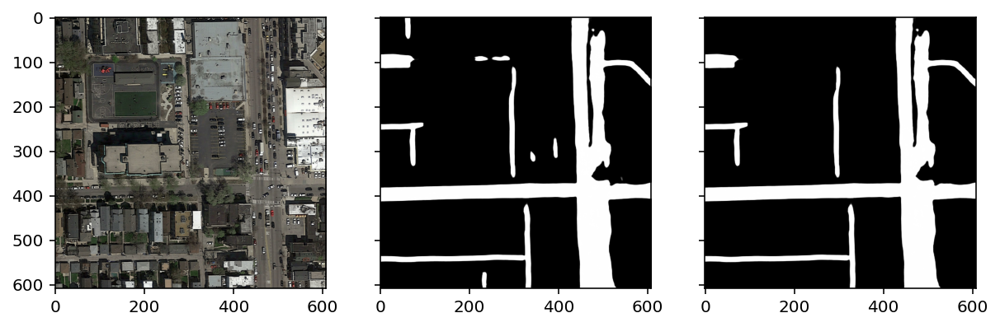

19


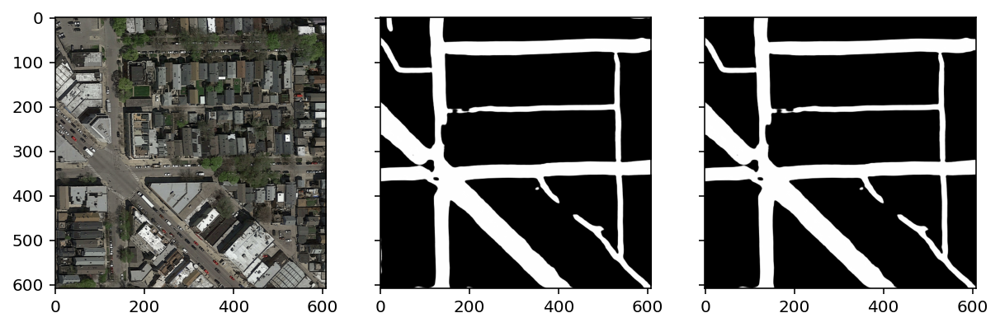

20


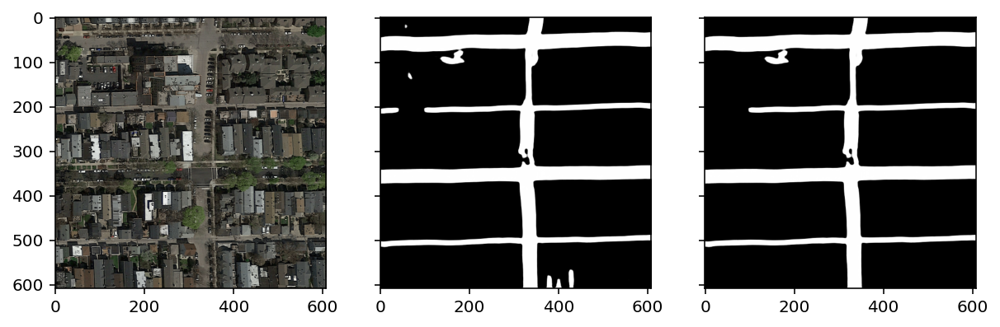

21


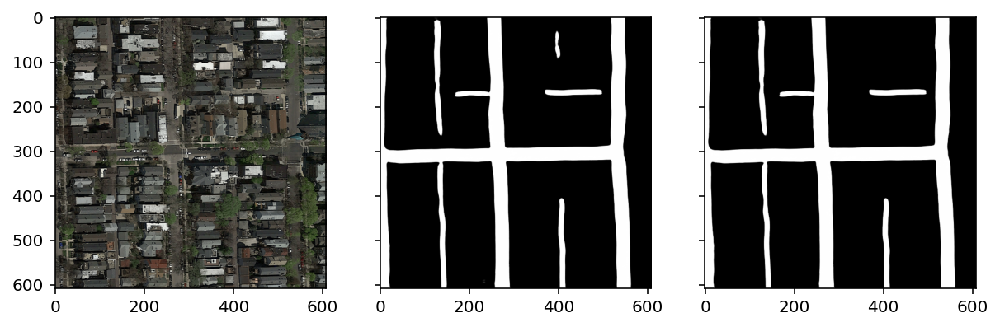

22


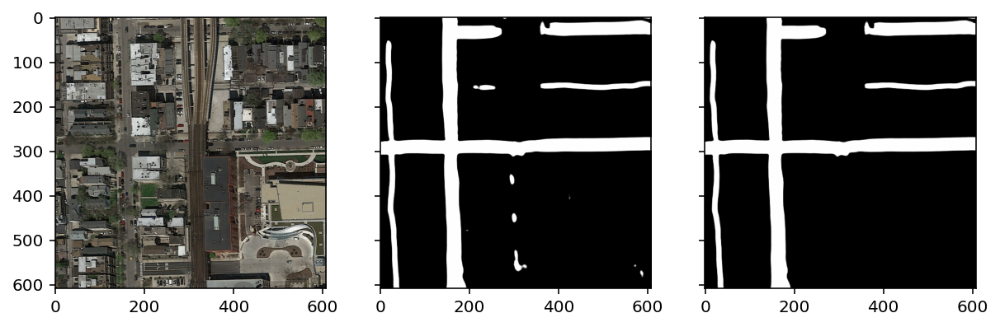

23


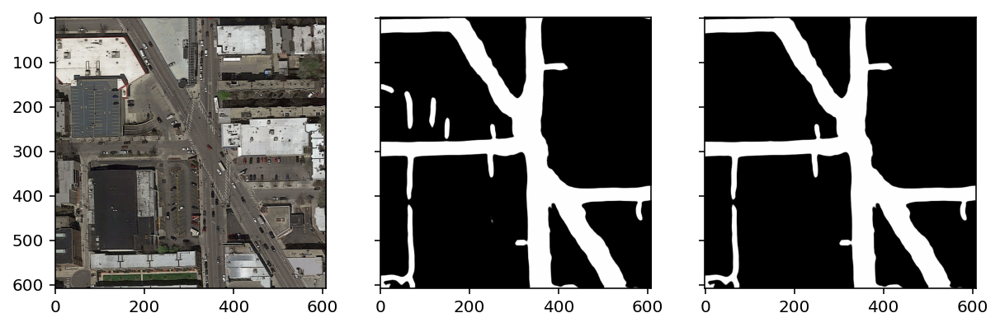

24


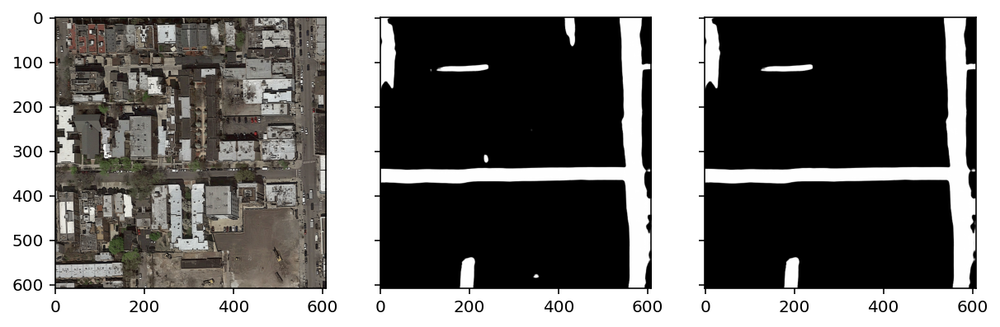

25


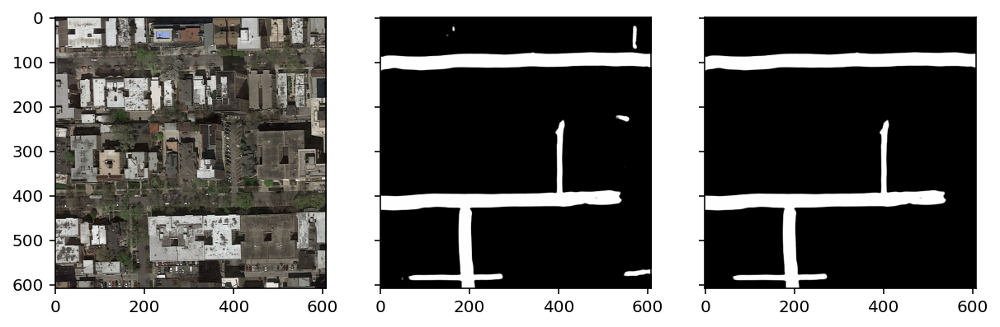

26


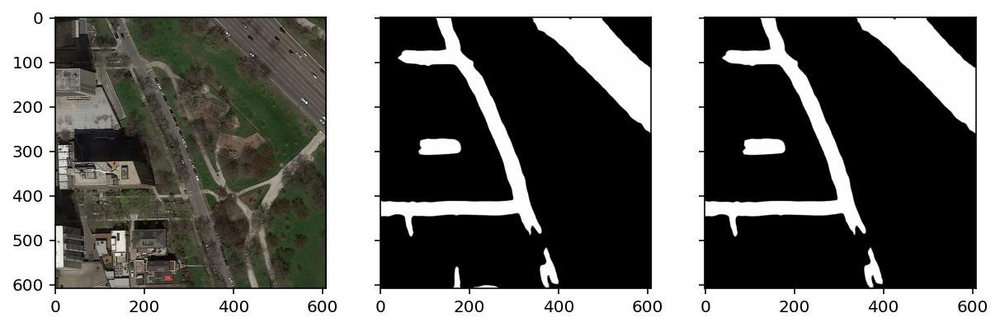

27


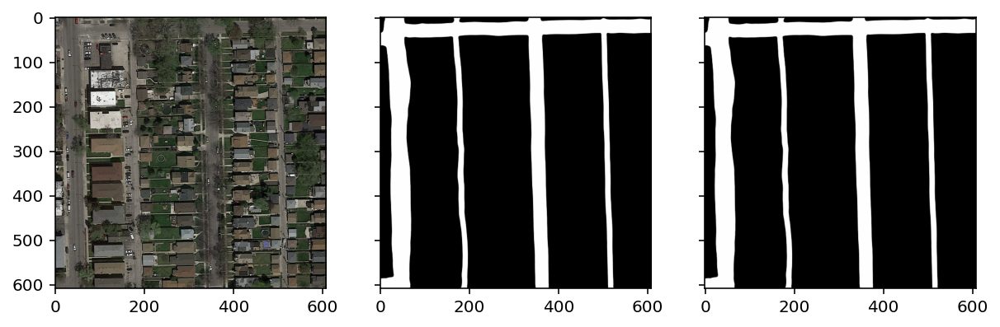

28


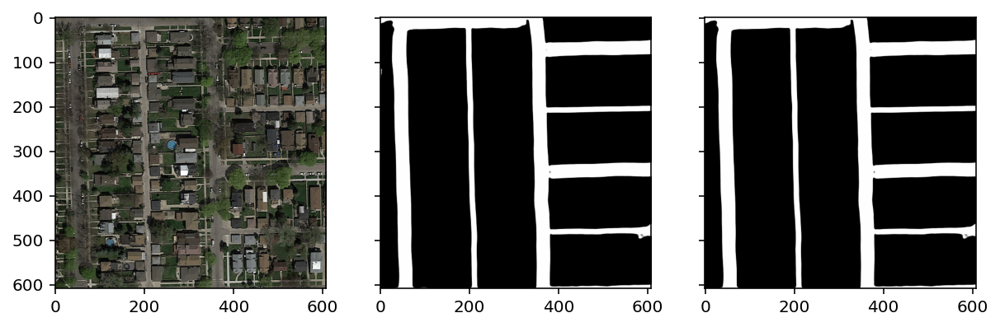

29


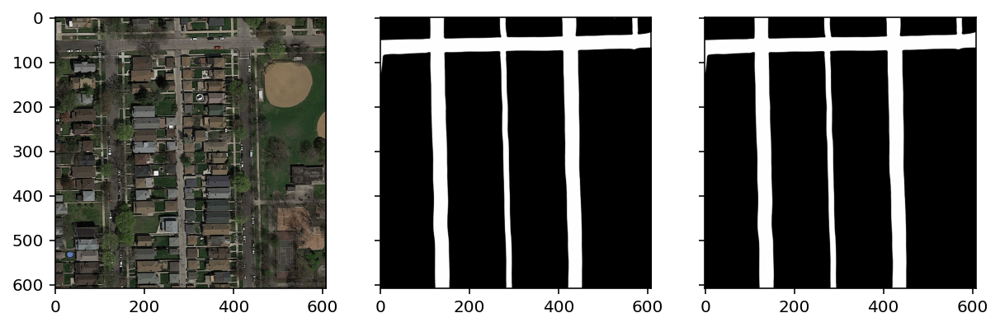

30


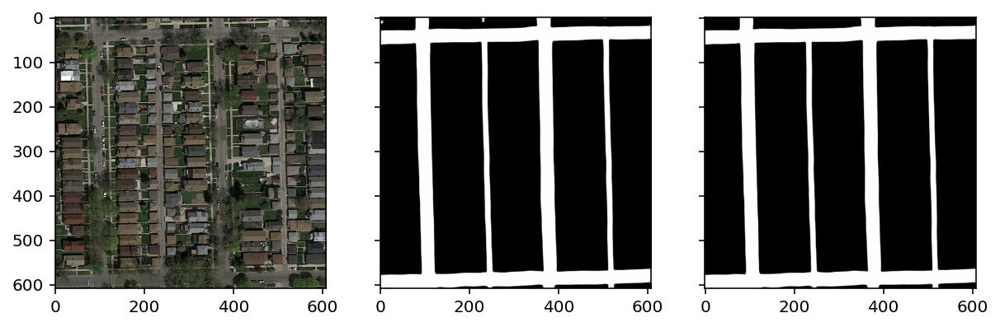

31


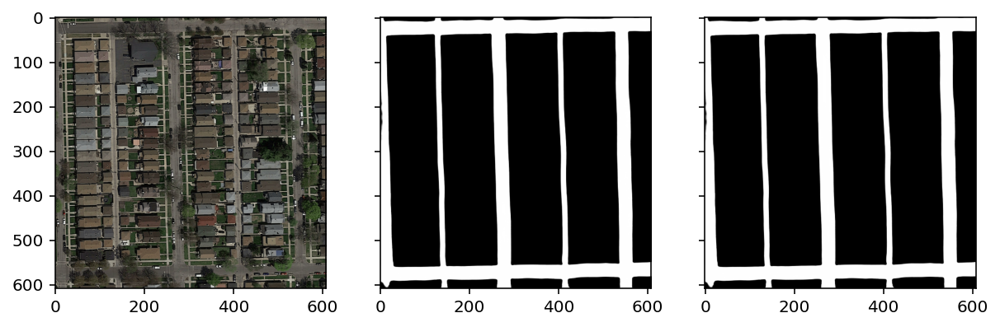

32


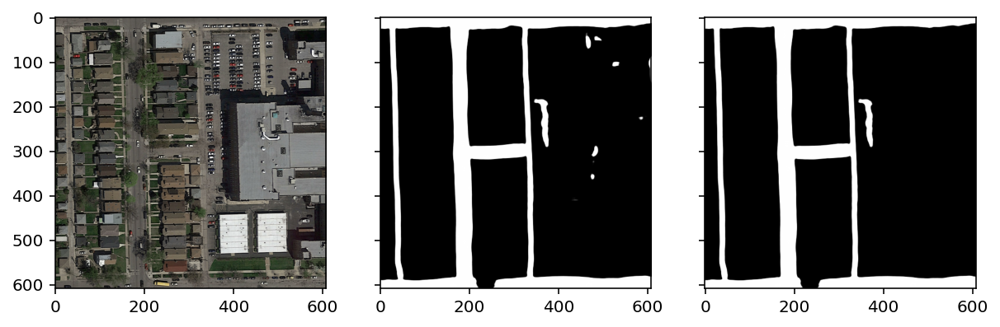

33


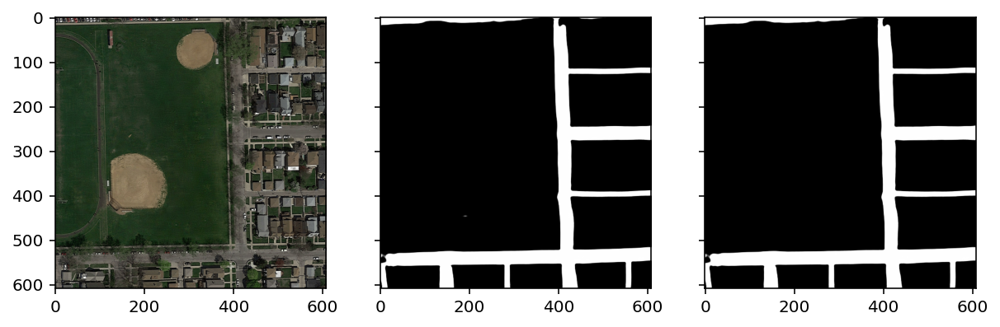

34


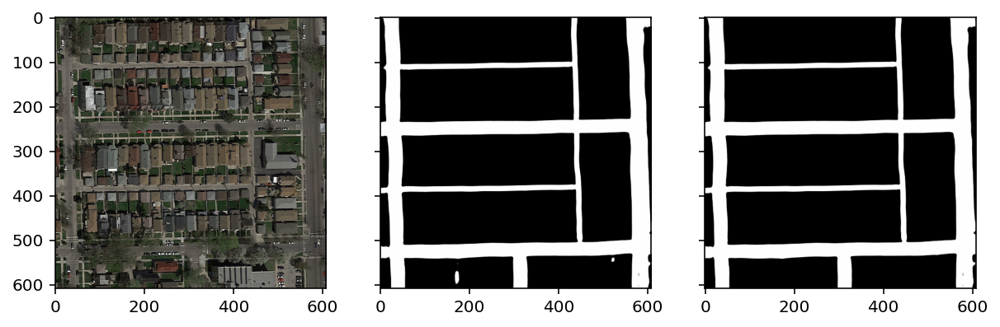

35


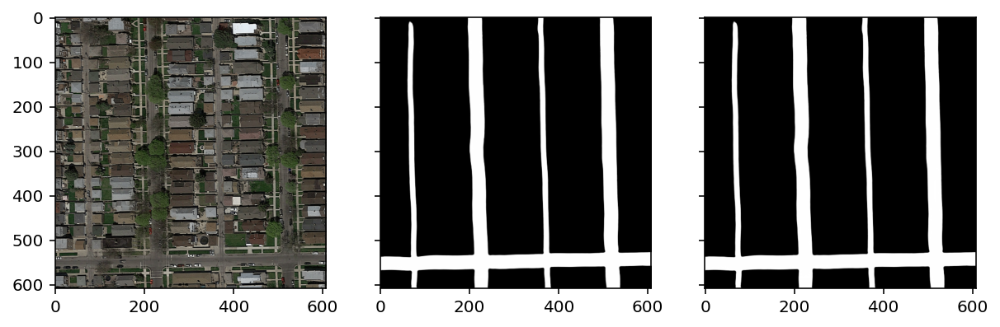

36


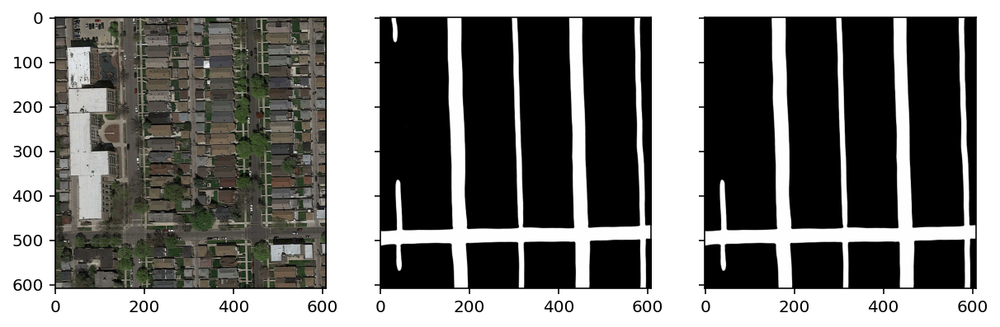

37


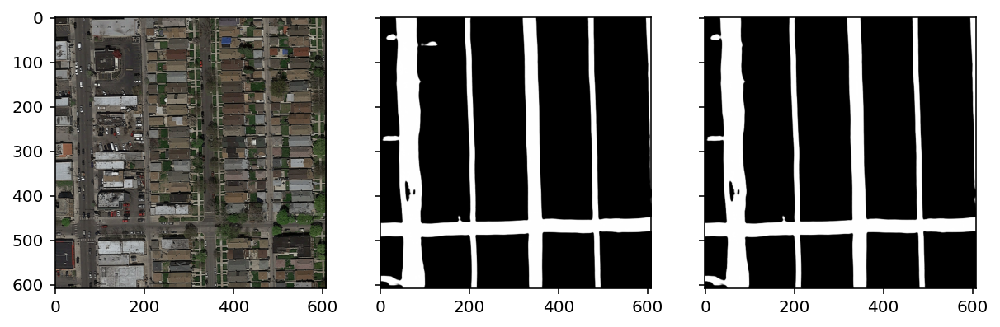

38


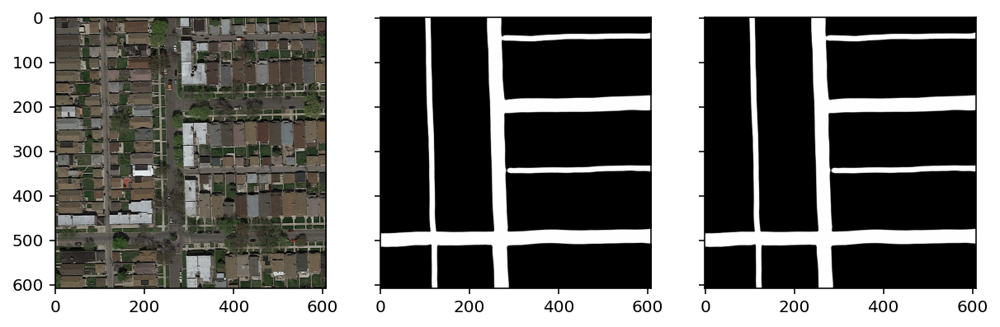

39


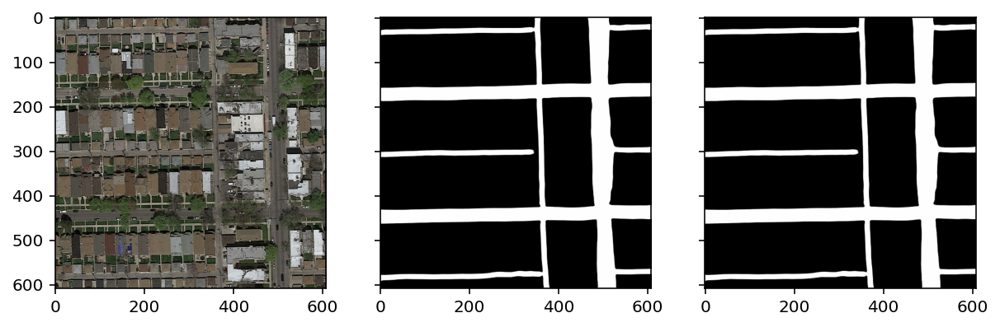

40


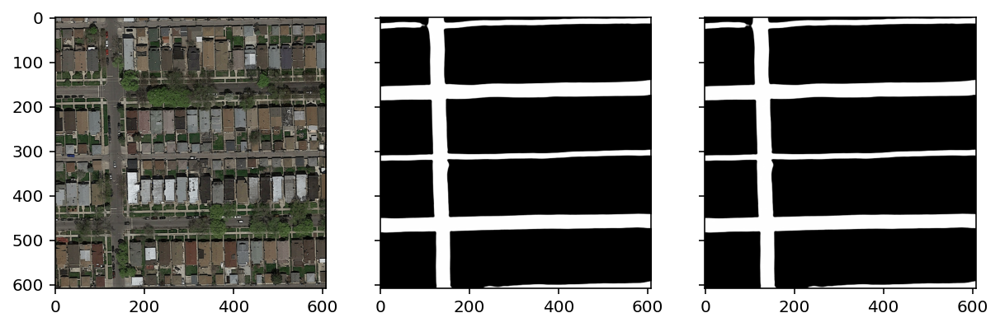

41


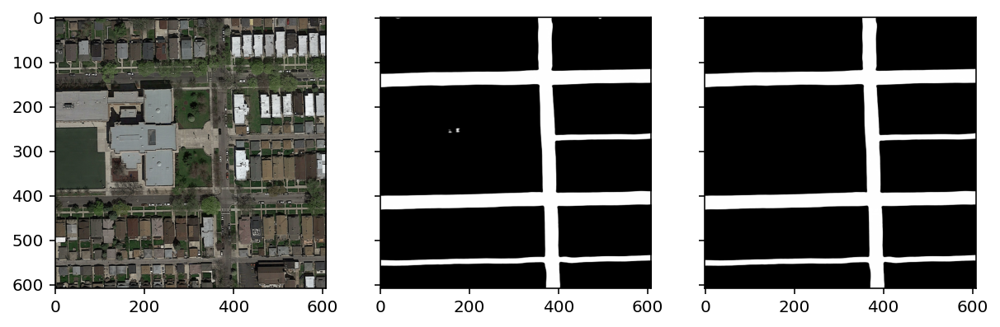

42


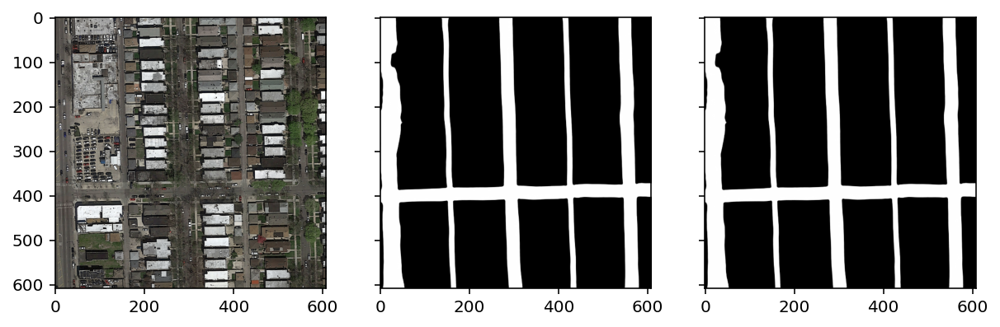

43


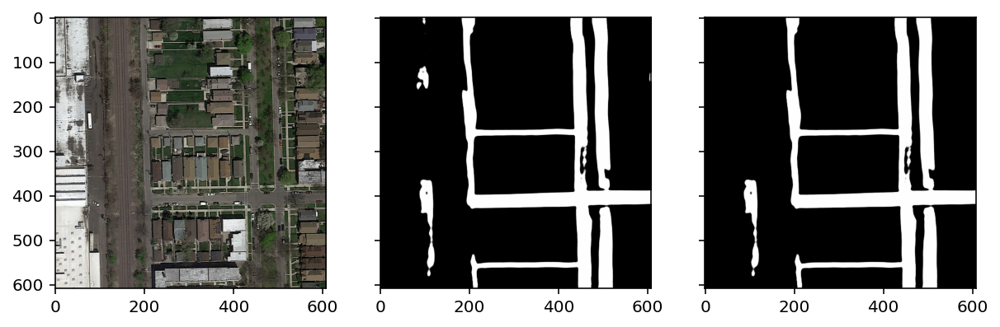

44


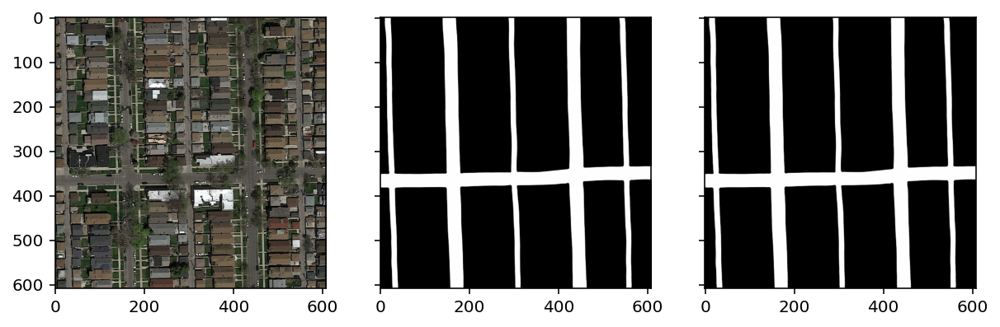

45


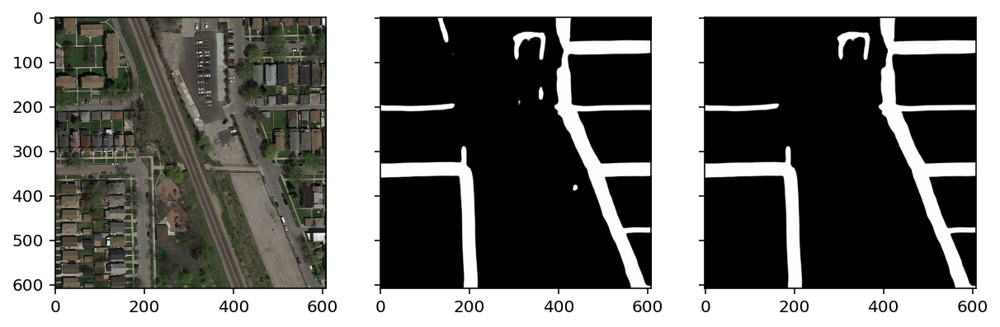

46


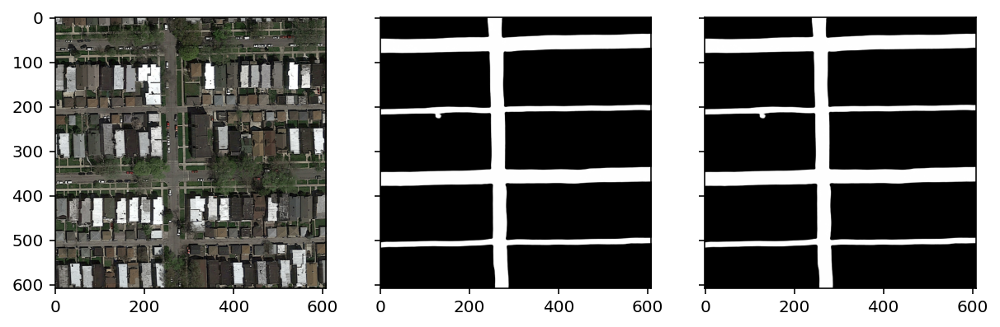

47


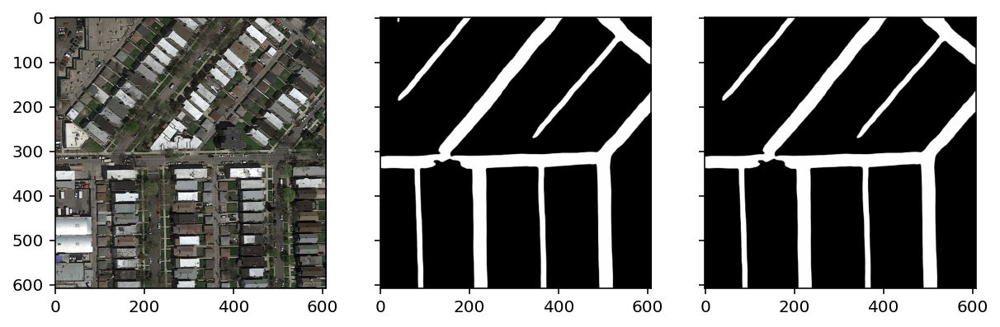

48


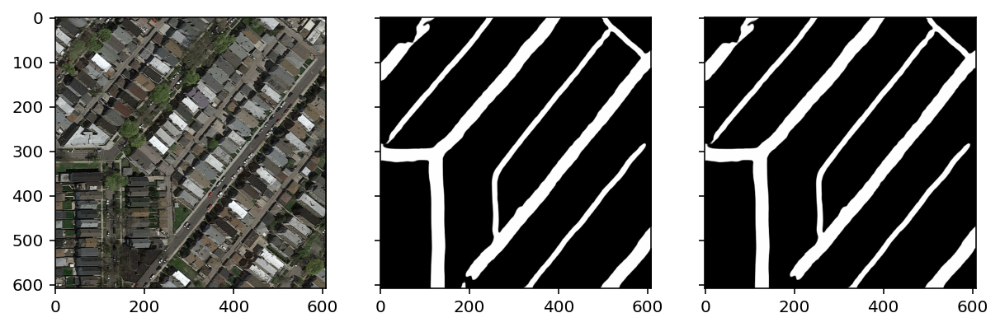

49


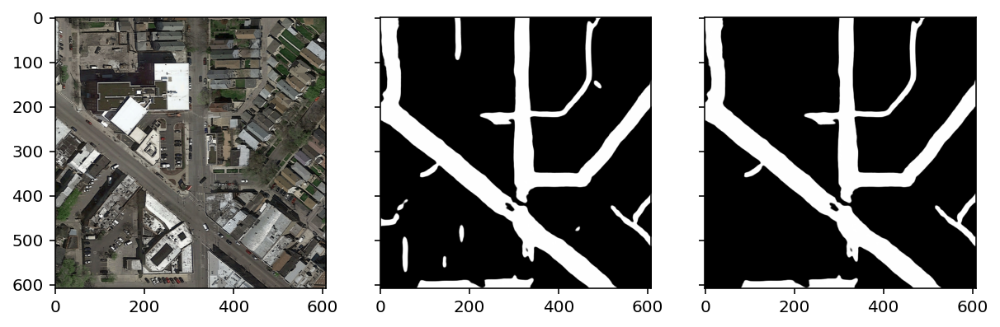

50


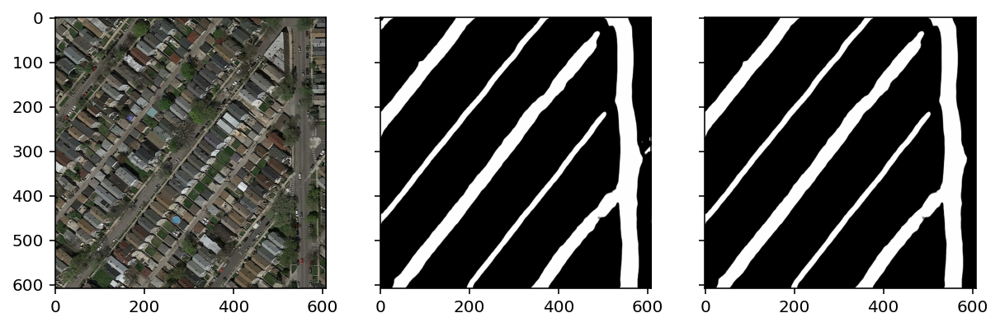

In [25]:
for i in range(1,51):
    print(i)
    show_stuff(i, show_adj=True)

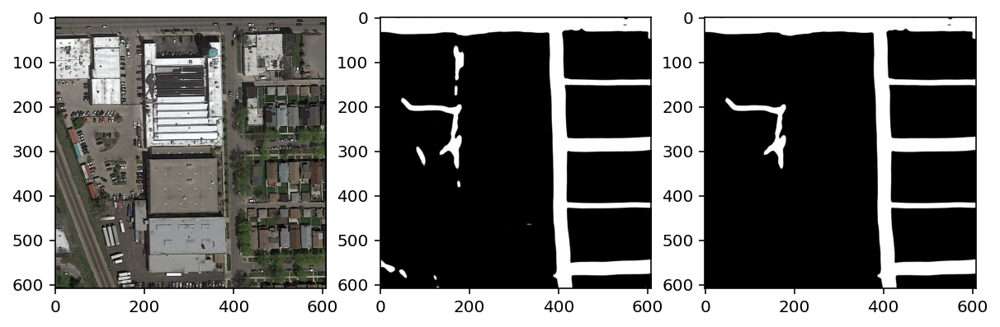

In [29]:
show_stuff(2, show_adj=True)

In [10]:
i=1
img, img_pred = load_imgs(i)
pred_path = f'data/test_predictions/prediction_{i:03}.png'

pred = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)

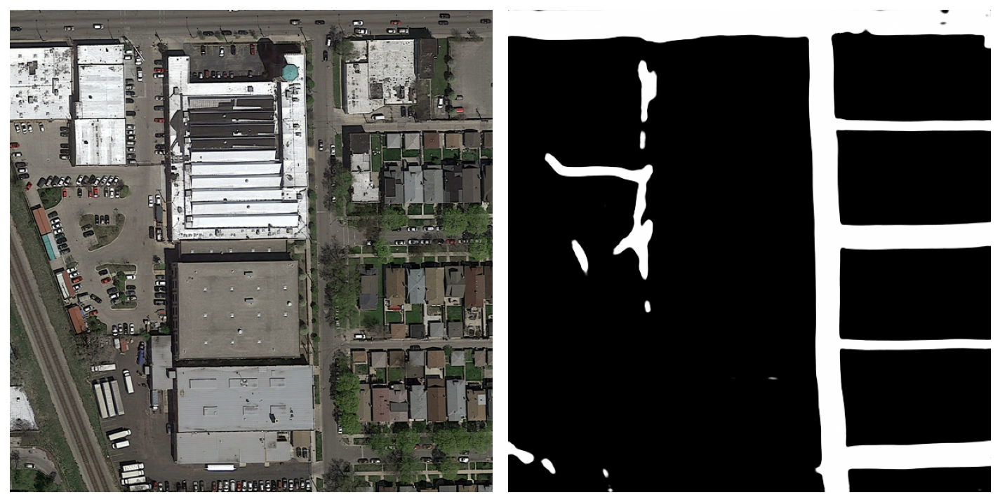

In [35]:
show_images(img, pred)

In [12]:
def show_image(img):
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(img, cmap='gray')
    plt.tight_layout()

In [13]:
# # Read image
# # im = cv2.imread("blob.jpg", cv2.IMREAD_GRAYSCALE)
# im = pred

# # Setup SimpleBlobDetector parameters.
# params = cv2.SimpleBlobDetector_Params()

# # params

# # Change thresholds
# params.minThreshold = 155
# params.maxThreshold = 255

# # Filter by Area.
# params.filterByArea = False
# # params.minArea = 1
# # params.maxArea = 5000

# # # Filter by Circularity
# params.filterByCircularity = False
# # params.minCircularity = 0.1

# # # Filter by Convexity
# params.filterByConvexity = False
# # params.minConvexity = 0.87

# # # Filter by Inertia
# params.filterByInertia = False
# # params.minInertiaRatio = 0.01

# detector = cv2.SimpleBlobDetector_create(params)

# # Detect blobs.
# keypoints = detector.detect(im)

# # Draw detected blobs as red circles.
# # cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS ensures the size of the circle corresponds to the size of blob
# im_with_keypoints = cv2.drawKeypoints(im, keypoints, np.array([]), (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# # Show keypoints
# show_image(im_with_keypoints)
# # cv2.imshow("Keypoints2", im_with_keypoints)
# # cv2.waitKey(0)

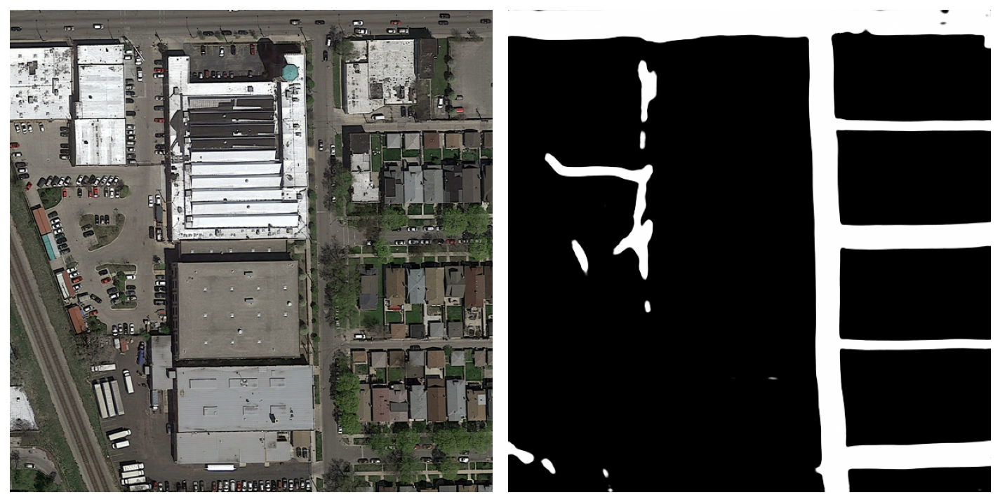

In [31]:
i=2
img, img_pred = load_imgs(i)
pred_path = f'data/test_predictions/prediction_{i:03}.png'

pred = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)
show_images(img, pred)

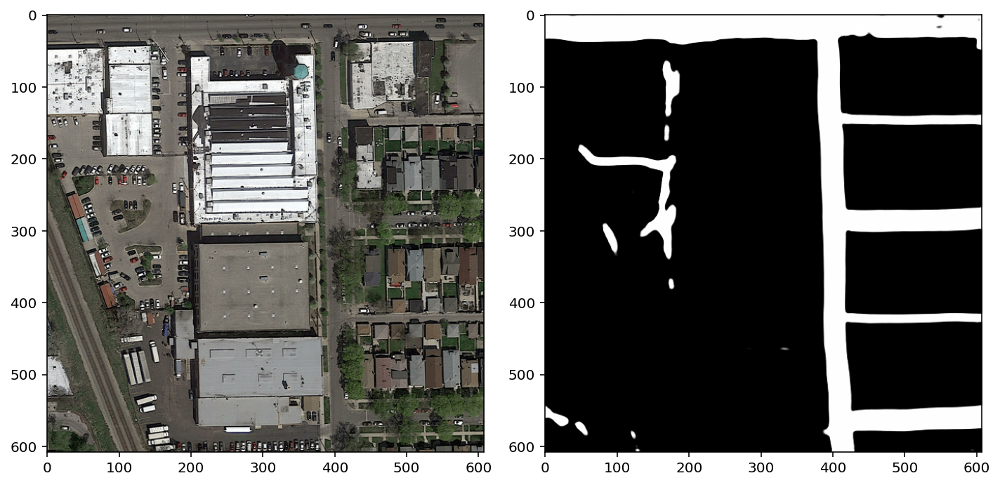

In [43]:
# img = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)[1]  # ensure binary

def remove_small_connected_components(img_pred, size_threshold=1500):
    num_labels, labels_im, stats, centroids = cv2.connectedComponentsWithStats(img_pred)

    pred_adj = img_pred.copy()

    #-------------------------------------------
    kp_cent = []
    for i in range(0, num_labels):
        centroid = centroids[i]
        stat = stats[i]
        size = stat[4]

        # print(size)
        # print(size < size_threshold)

        # mode = 'debug'
        mode = 'run'
        if mode == 'debug':
            kp_cent.append(cv2.KeyPoint(centroid[0], centroid[1], min(10, round(np.log2(size)))))

            if i==0:
                print(size)
                pred_adj[labels_im == i] = 100

        elif mode == 'run':
            if (size < size_threshold):
                
                # Add centroids for printing
                kp_cent.append(cv2.KeyPoint(centroid[0], centroid[1], round(size/10)))

                # Makes output image dark at small blobs
                # pred_adj[labels_im == i] = 100

    #-------------------------------------------

    im_with_keypoints = cv2.drawKeypoints(pred_adj, kp_cent, np.array([]), (255,0,0), cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    return pred_adj,im_with_keypoints

pred_adj, im_with_keypoints = remove_small_connected_components(pred)
# show_image(im_with_keypoints)
# show_images(img, im_with_keypoints)
show_images_smart([img, pred], ['viridis', 'gray'])
# show_stuff()

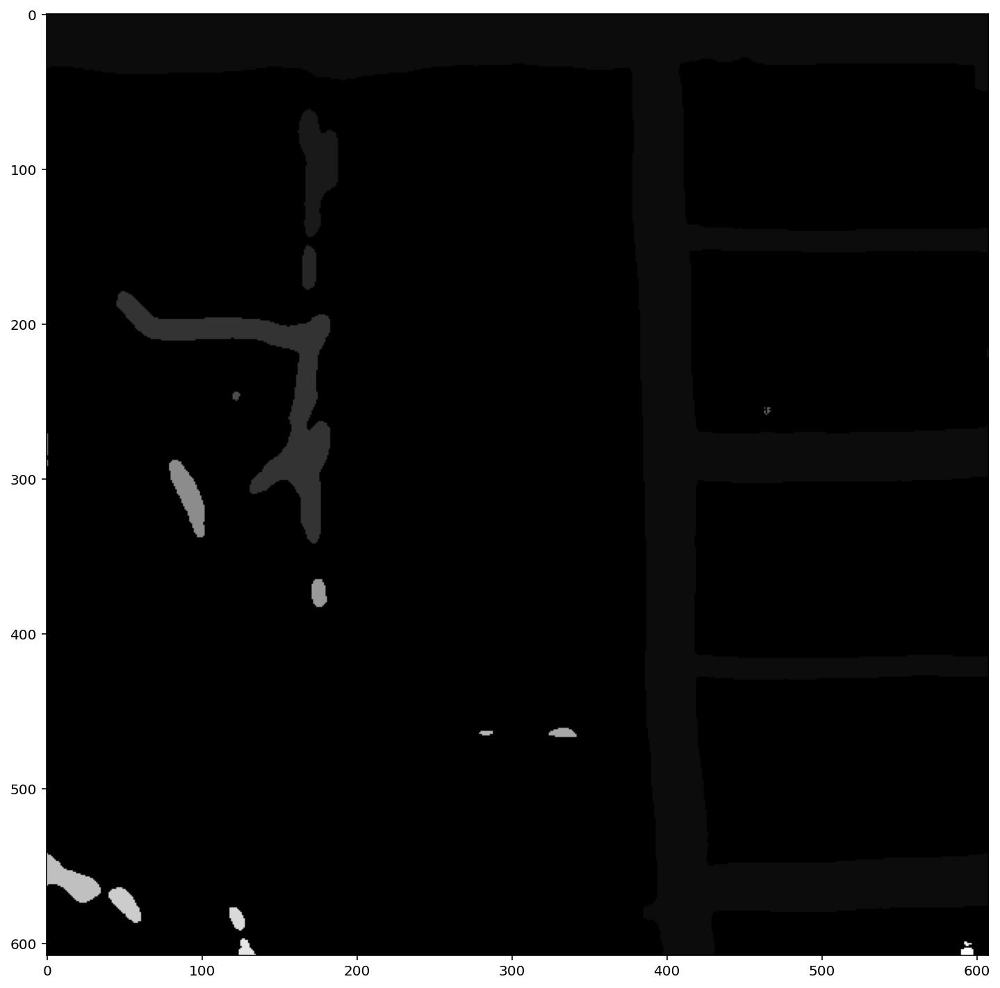

In [33]:
num_labels, labels_im, stats, centroids = cv2.connectedComponentsWithStats(pred)
show_image(labels_im)

In [18]:
for i in range(1, 51):
    # print(i)

    pred_path = f'data/test_predictions/prediction_{i:03}.png'
    out_path = f'data/adj_predictions/prediction_{i:03}.png'

    pred = cv2.imread(pred_path, cv2.IMREAD_GRAYSCALE)
    
    pred_adj, _ = remove_small_connected_components(pred)
    # break
    cv2.imwrite(out_path, pred_adj)

# pred_adj.shape()

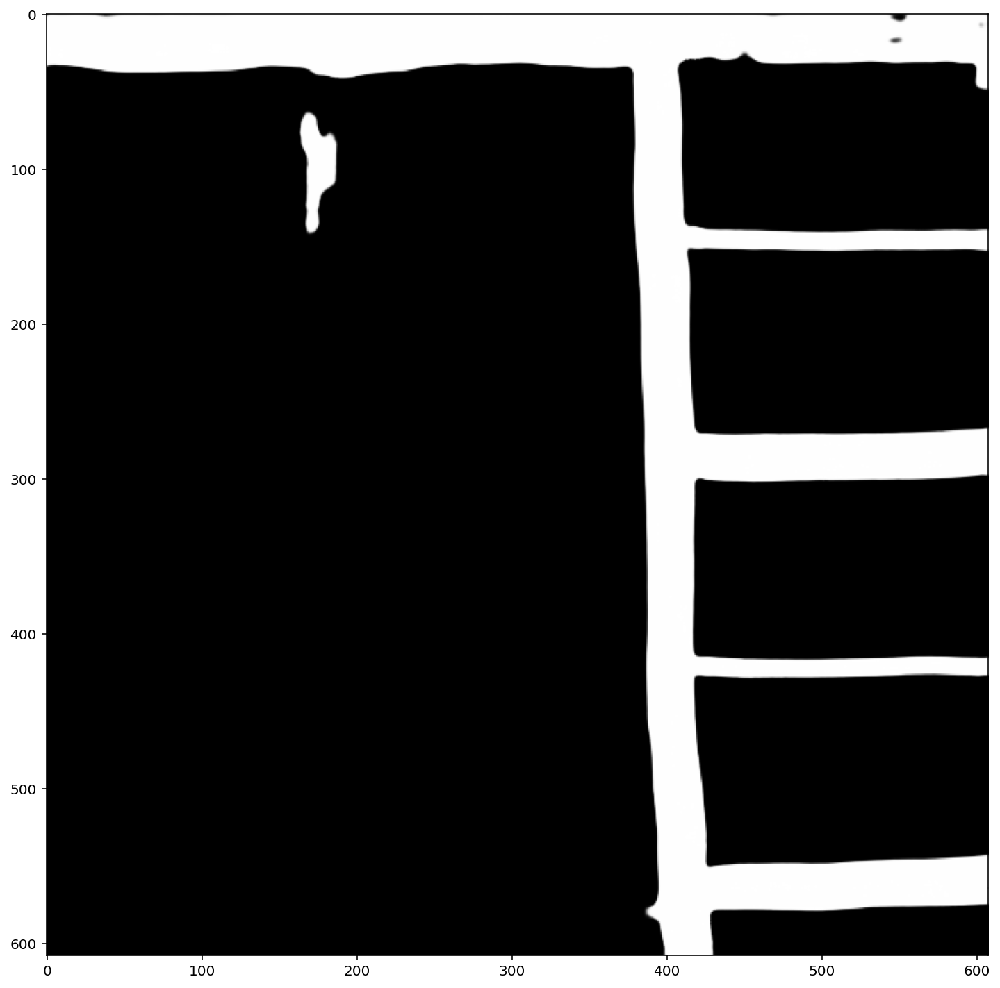

In [22]:
show_image(pred_adj)

In [34]:
kernel = np.ones((5,5),np.uint8)
dilation = cv2.erode(pred,kernel,iterations = 2)

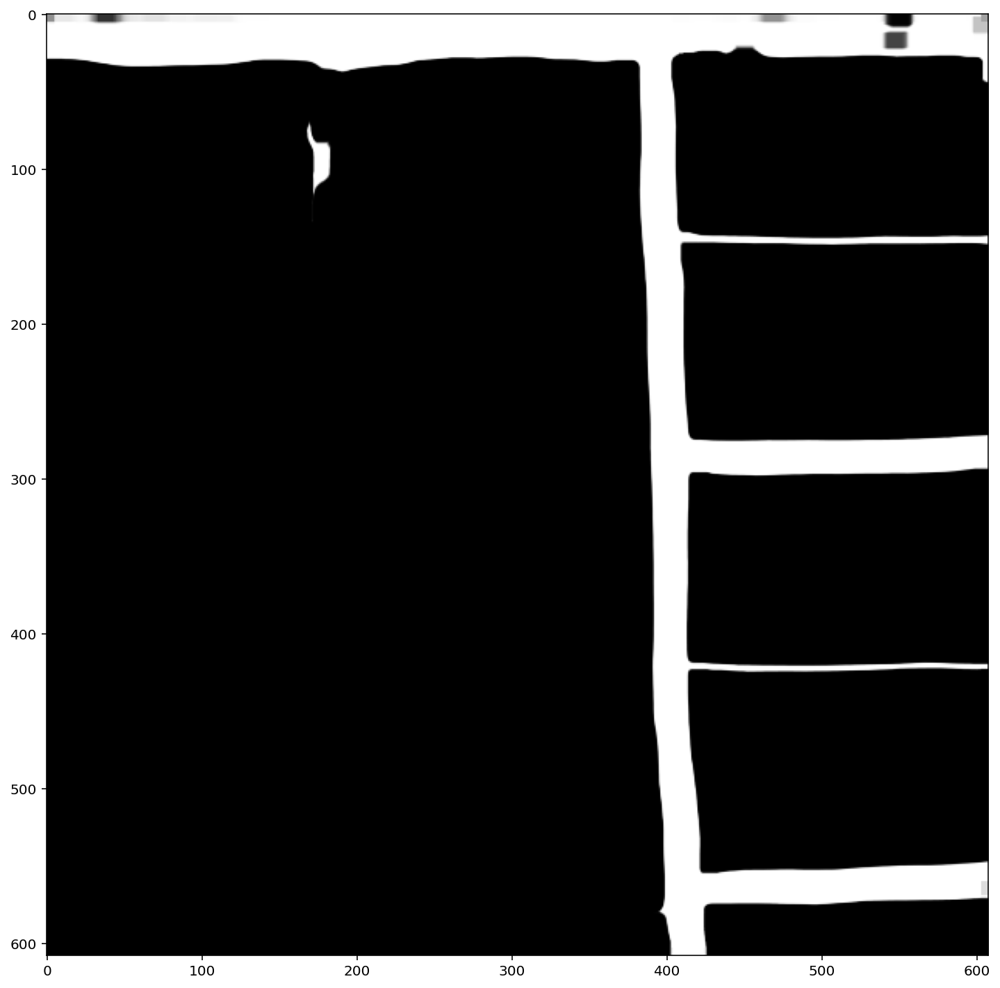

In [35]:
show_image(dilation)

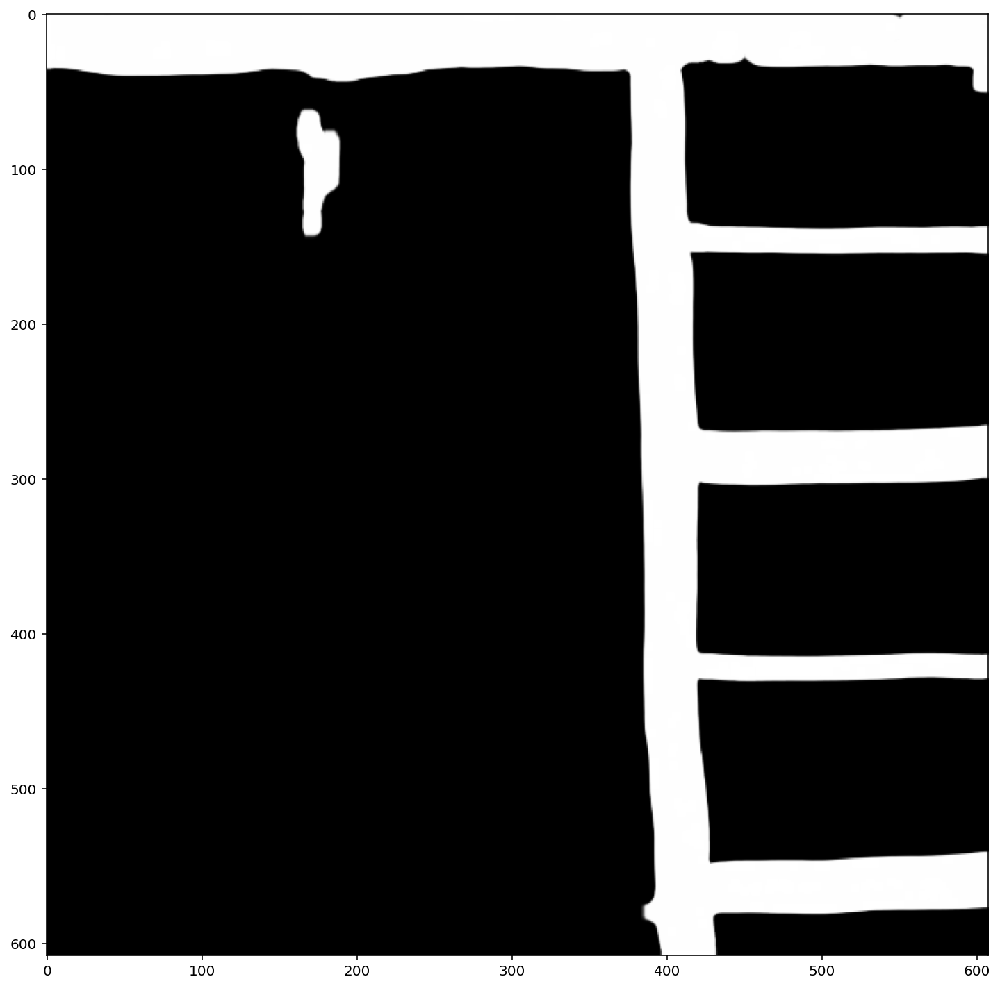

In [29]:
size_k = 50
kernel = np.ones((size_k,size_k),np.uint8)
opening = cv2.morphologyEx(img, cv2.MORPH_OPEN, kernel)
show_image(dilation)